# **Importing the Required Libraries**

In [3]:
import os
import cv2
import numpy as np

from sklearn.cluster import KMeans
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from scipy.cluster.vq import vq
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix

import matplotlib.pyplot as plt

**Mounting Google Drive**

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **Functions**

**Function to extract features using SIFT detector**

In [5]:
def extract_sift_features(img):
    sift = cv2.xfeatures2d.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(img, None)
    return keypoints, descriptors

**Function to calculate BoW representation of images**

In [6]:
def calculate_bow(descriptors, vocabulary):
    bow_hist = np.zeros((1, len(vocabulary)), dtype=np.float32)
    if descriptors is not None:
        # Find nearest cluster center for each descriptor using k-means clustering
        words, _ = vq(descriptors, vocabulary)
        # Count occurrences of each word in the vocabulary
        for w in words:
            bow_hist[0][w] += 1
    return bow_hist

**Function to Display Confusion Matrix**

In [7]:
def showconfusionmatrix(cm):
    # Display the confusion matrix as a heatmap
    plt.matshow(cm)
    plt.title('Confusion matrix')
    plt.colorbar()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

    # Calculate TP, TN, FP, and FN using NumPy
    tn = cm.sum(axis=0) - np.diag(cm)  # Sum of all non-diagonal elements in each column
    fp = cm.sum(axis=1) - np.diag(cm)  # Sum of all non-diagonal elements in each row
    fn = np.diag(cm)  # Diagonal elements of the matrix
    tp = cm.sum() - (tn + fp + fn)  # Total number of elements minus all other values

    print("True Positives:", tp)
    print("False Positives:", fp)

# **Loading the Dataset**

**Saving Paths and Feature Extraction**

In [8]:
flowers_path = '/content/drive/MyDrive/flower_photos/'

In [9]:
dataset_images = []
dataset_labels = []
path = []

In [10]:
for class_name in os.listdir(flowers_path):
    class_path = flowers_path + "/" + class_name + "/"
    for img_file in os.listdir(class_path):
        img_path = class_path + img_file
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        keypoint, descriptor = extract_sift_features(img)
        dataset_images.append(descriptor)
        dataset_labels.append(class_name)
        path.append(img_path)

1


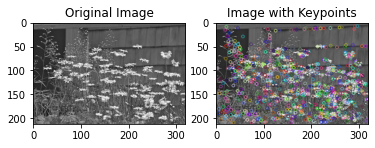

2


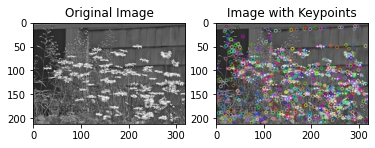

3


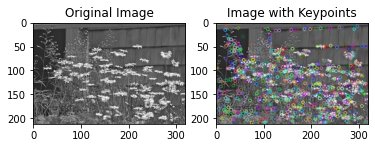

4


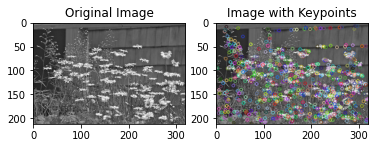

5


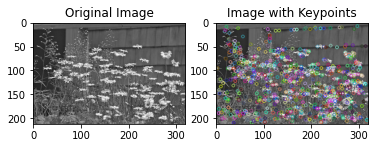

6


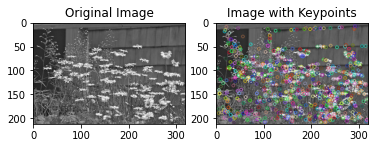

7


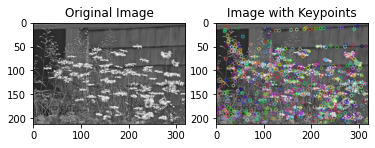

8


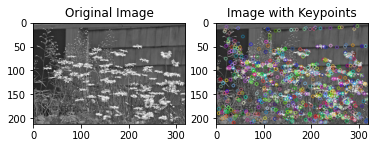

9


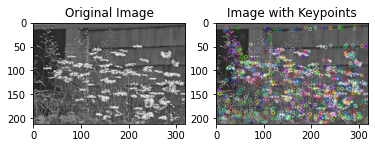

10


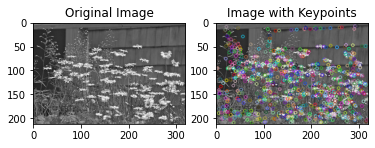

11


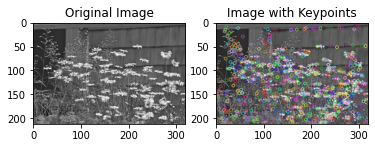

12


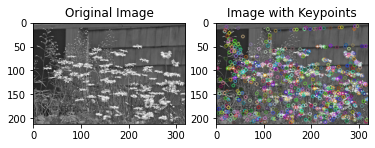

13


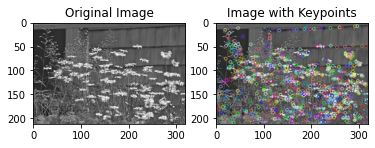

14


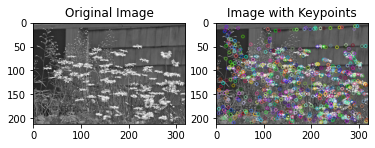

15


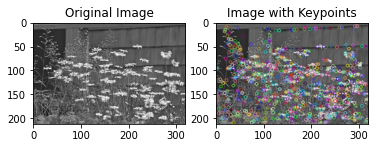

16


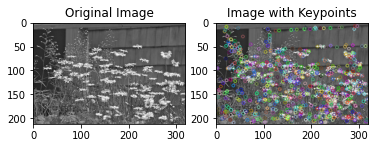

17


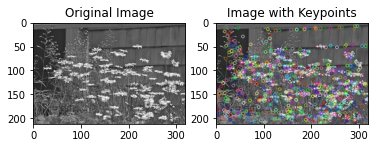

18


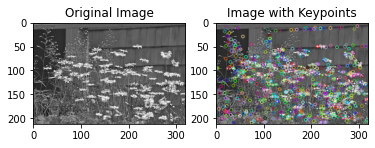

19


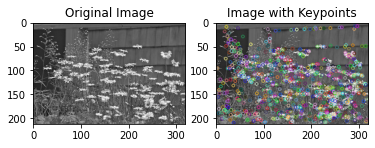

20


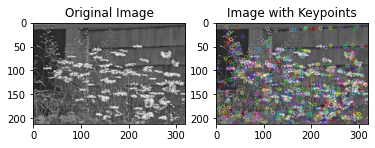

21


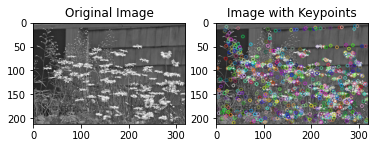

22


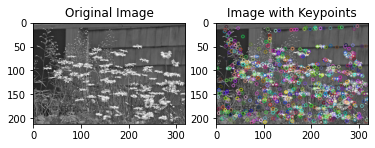

23


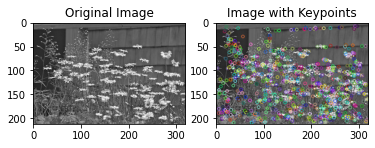

24


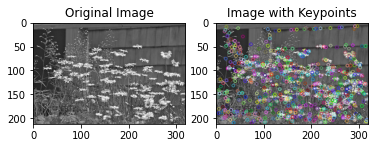

25


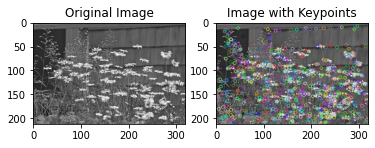

26


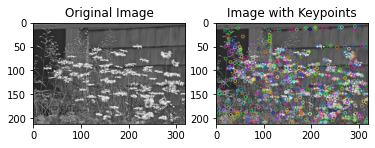

27


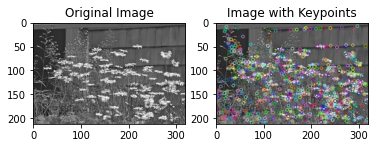

28


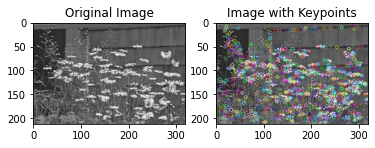

29


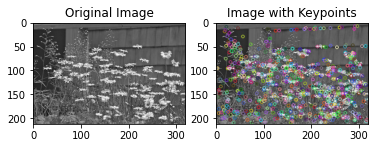

30


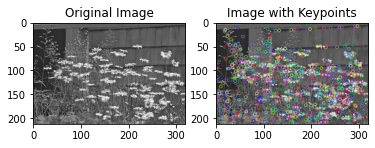

31


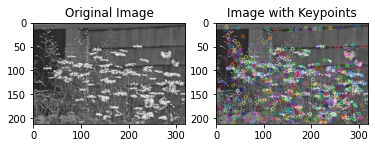

32


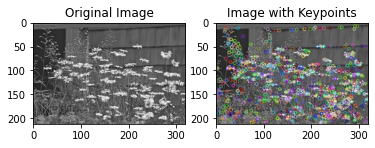

33


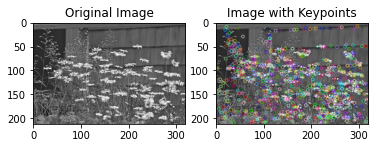

34


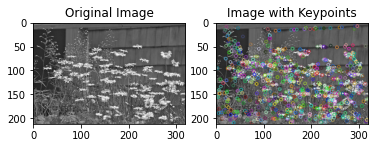

35


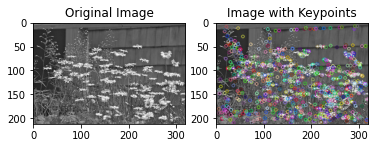

36


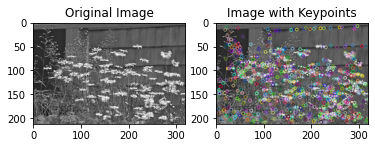

37


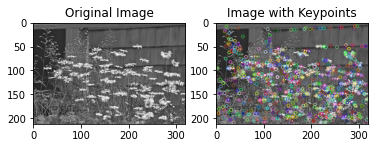

38


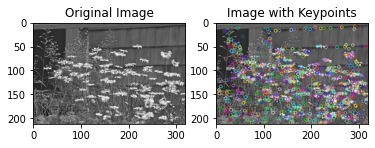

39


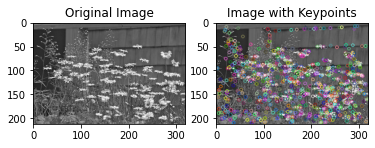

40


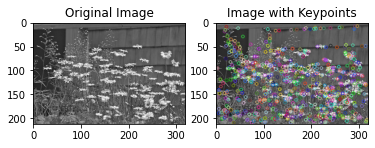

41


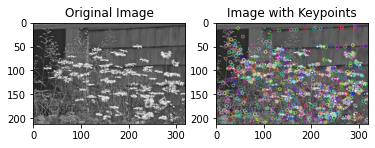

42


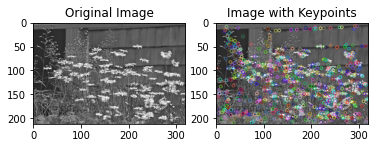

43


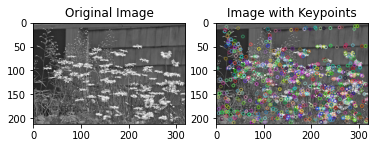

44


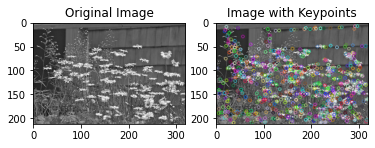

45


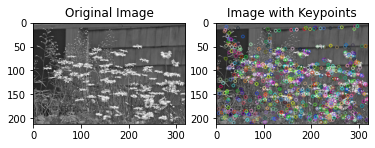

46


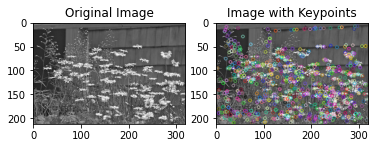

47


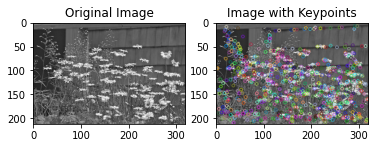

48


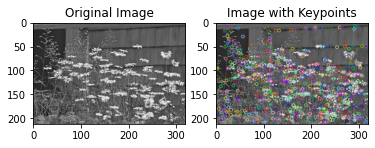

49


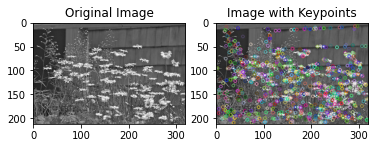

50


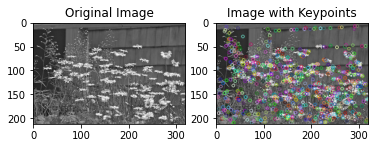

51


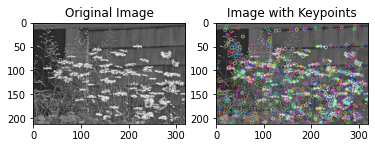

52


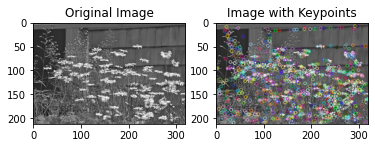

53


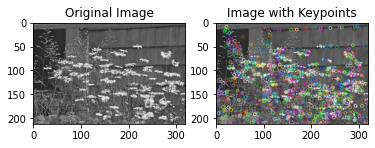

54


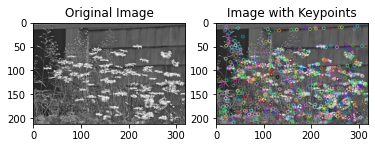

55


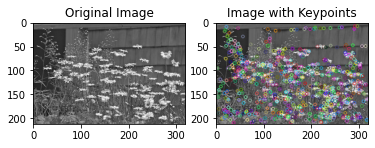

56


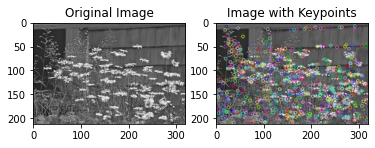

57


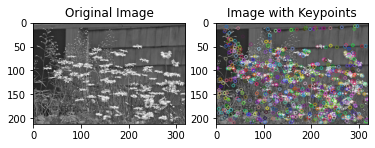

58


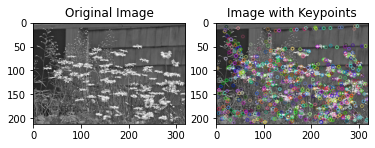

59


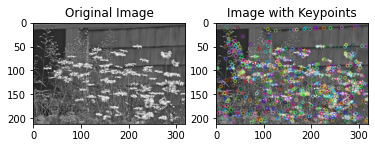

60


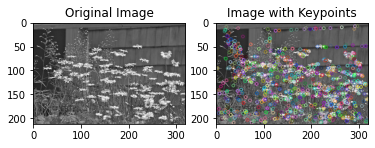

61


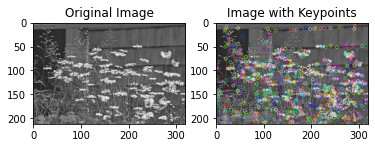

62


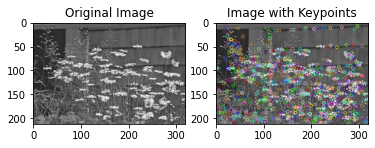

63


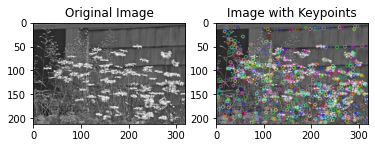

64


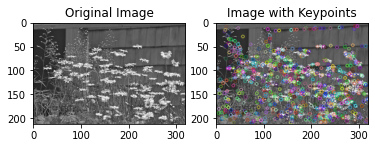

65


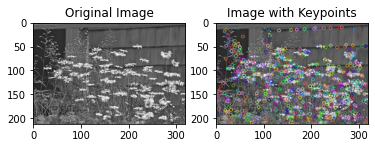

66


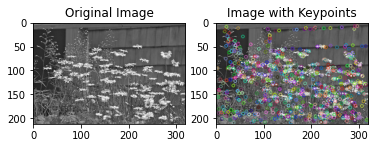

67


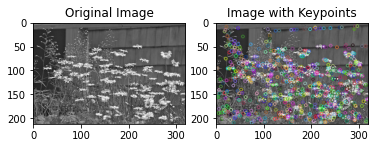

68


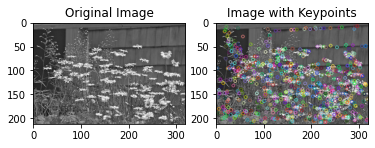

69


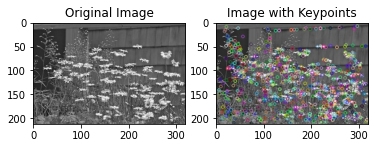

70


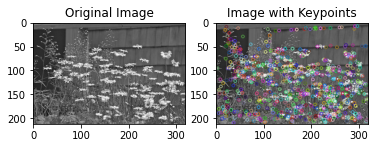

71


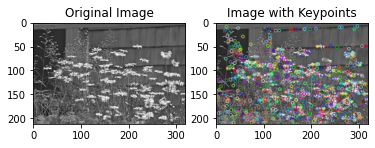

72


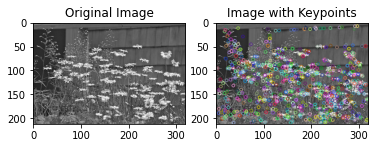

73


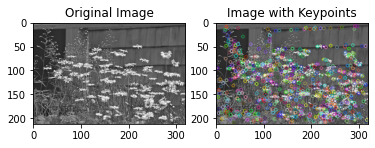

74


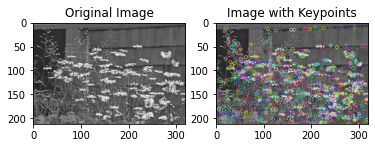

75


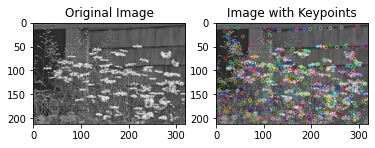

76


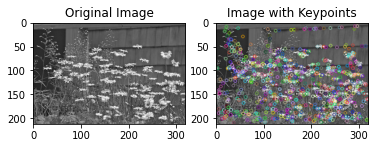

77


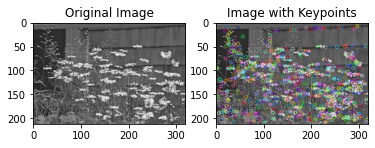

78


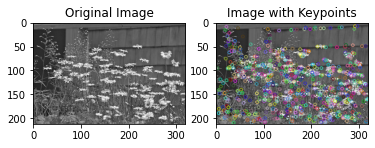

79


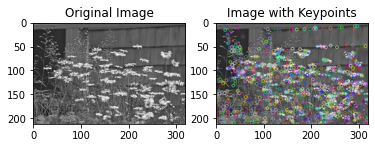

80


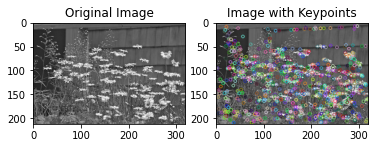

81


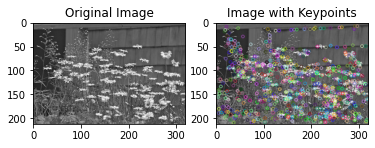

82


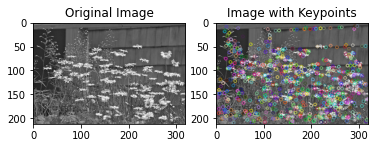

83


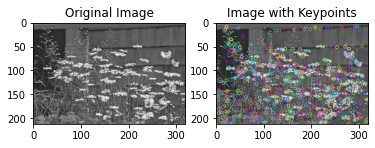

84


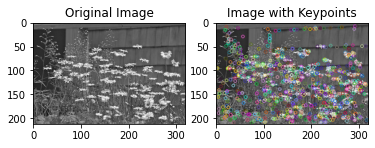

85


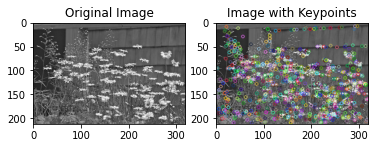

86


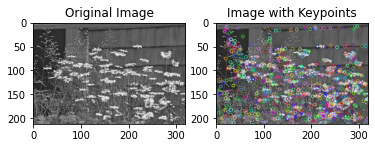

87


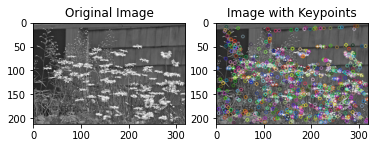

88


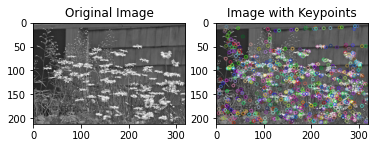

89


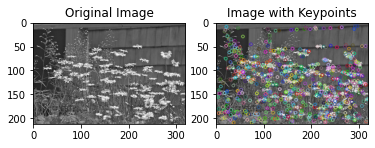

90


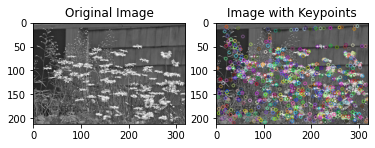

91


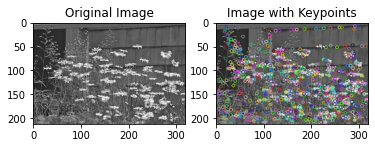

92


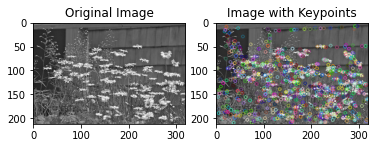

93


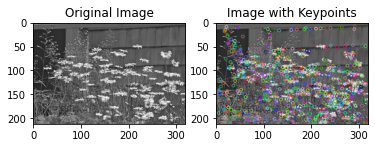

94


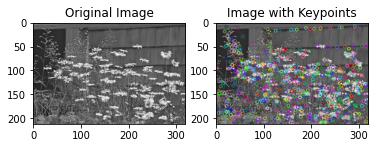

95


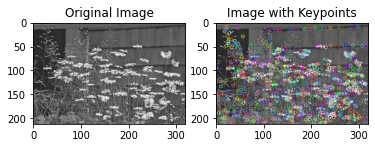

96


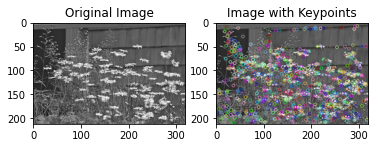

97


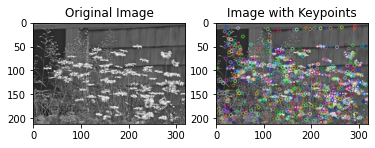

98


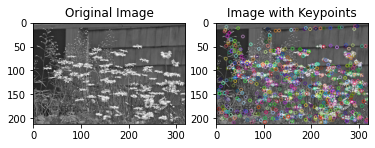

99


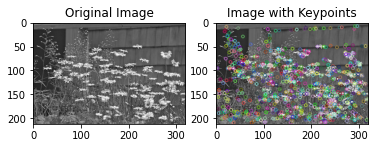

100


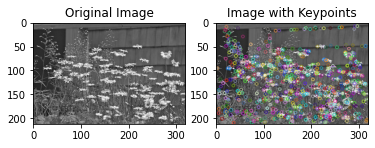

101


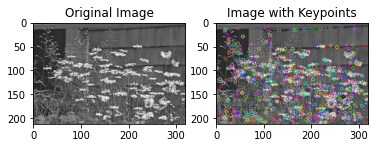

102


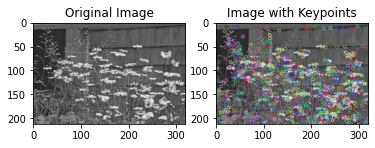

103


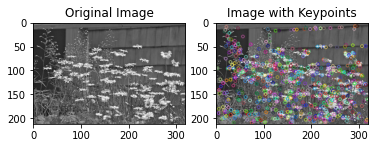

104


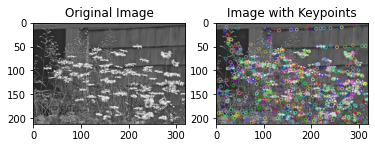

105


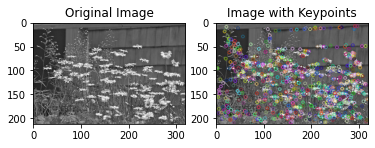

106


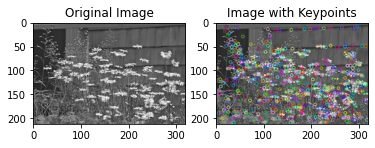

107


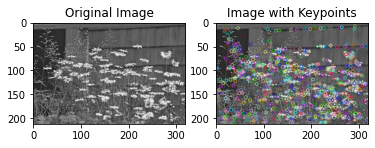

108


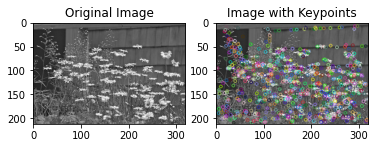

109


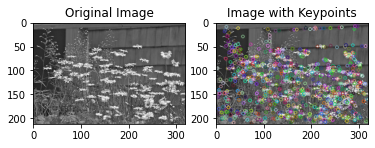

110


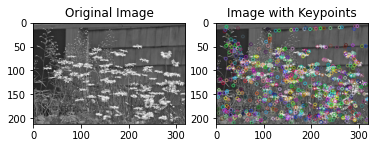

111


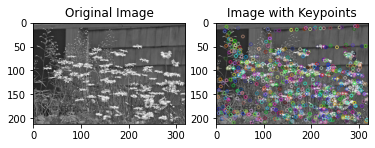

112


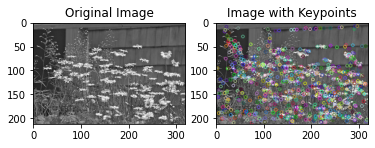

113


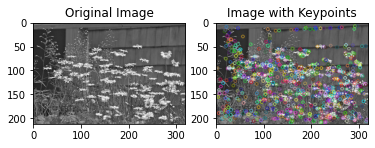

114


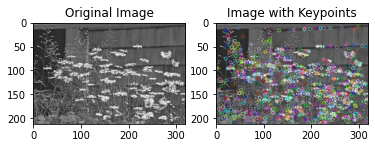

115


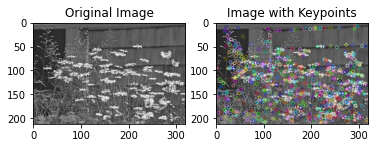

116


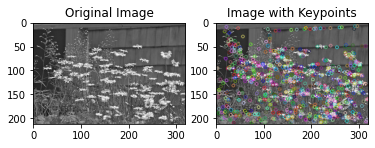

117


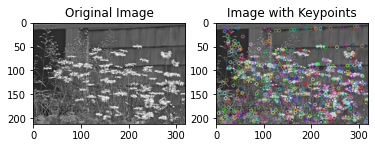

118


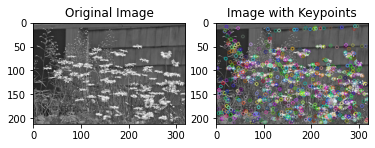

119


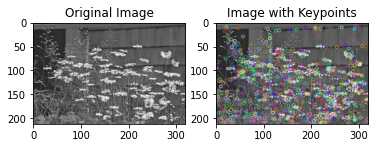

120


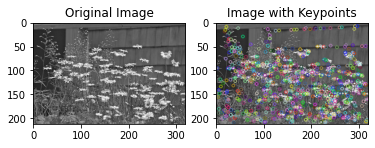

121


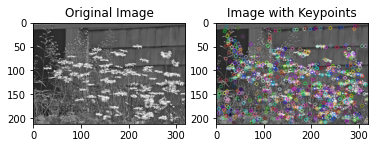

122


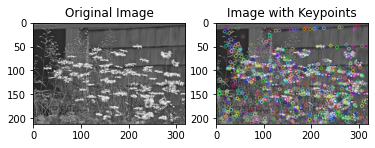

123


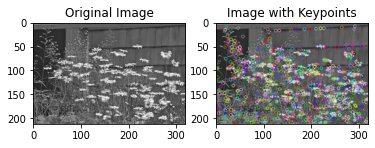

124


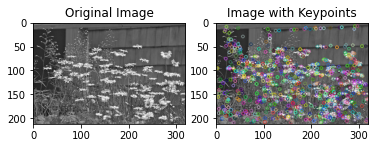

125


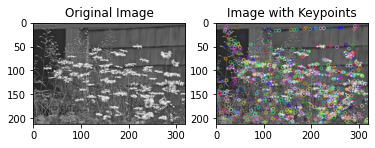

126


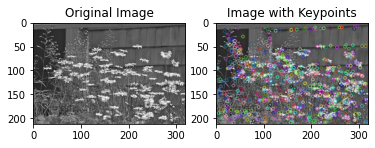

127


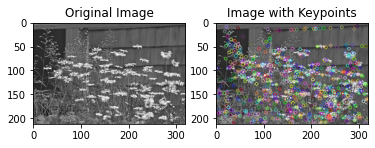

128


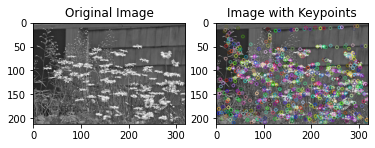

129


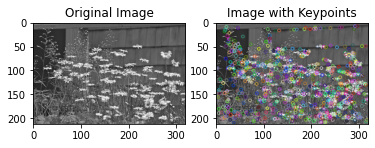

130


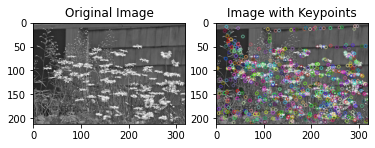

131


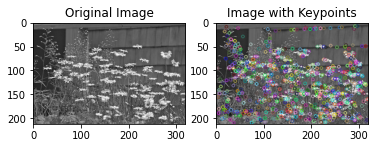

132


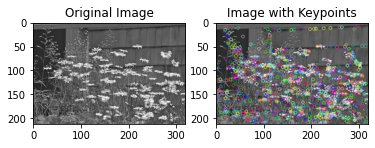

133


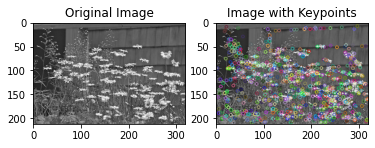

134


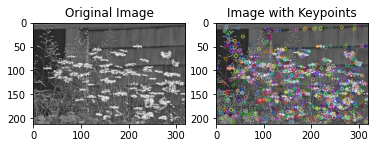

135


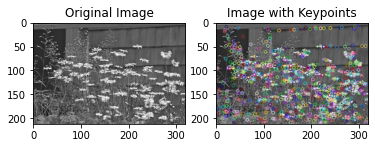

136


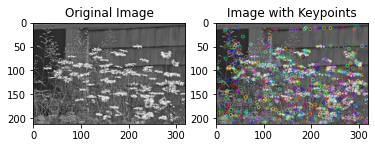

137


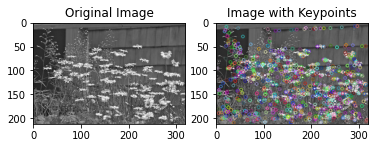

138


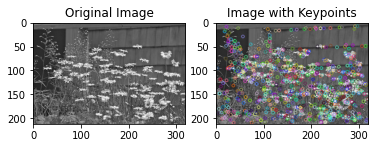

139


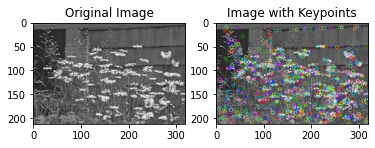

140


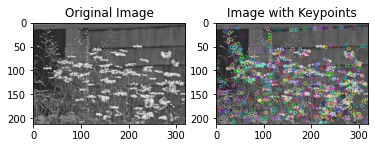

141


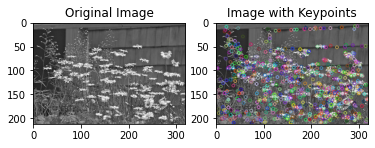

142


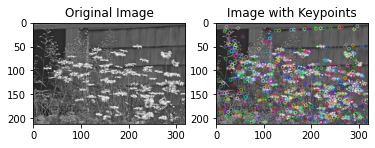

143


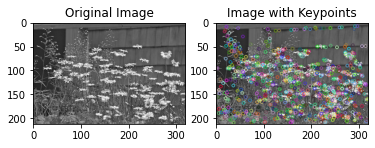

144


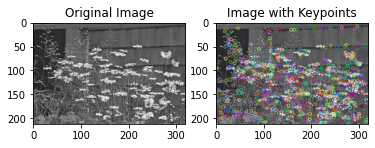

145


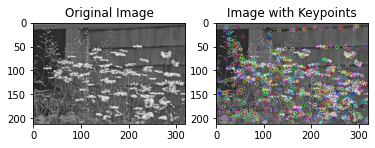

146


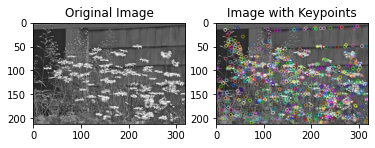

147


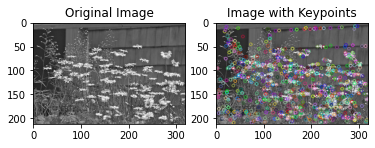

148


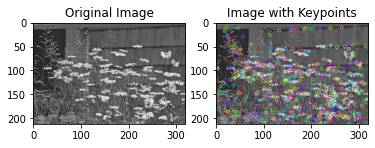

149


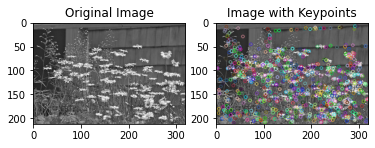

150


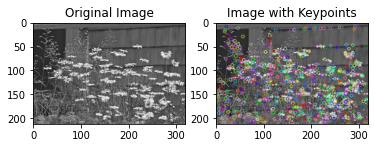

151


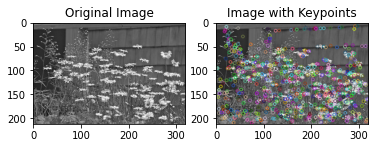

152


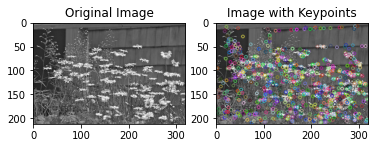

153


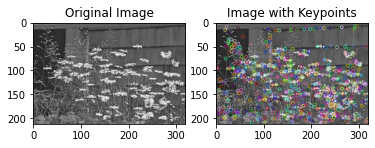

154


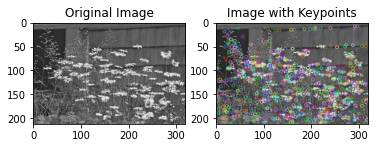

155


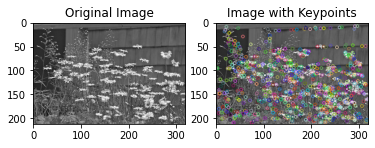

156


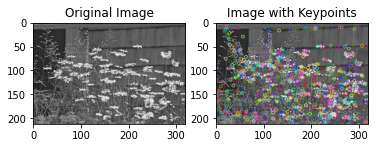

157


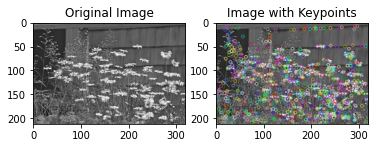

158


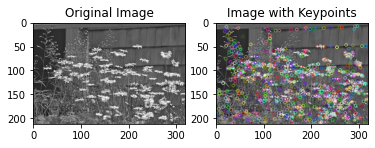

159


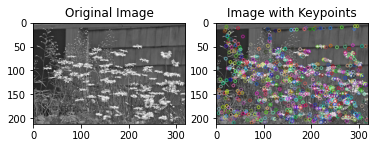

160


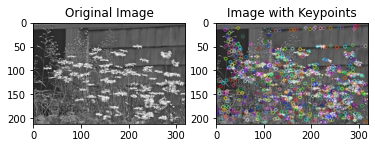

161


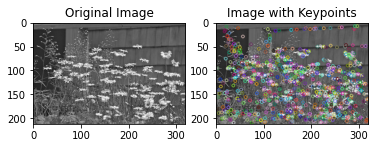

162


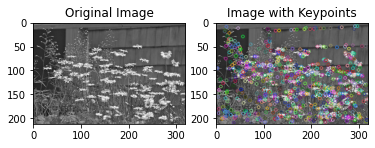

163


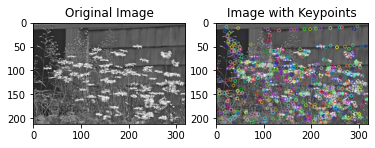

164


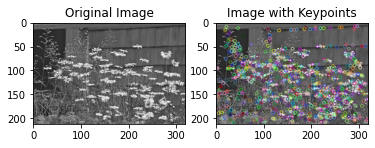

165


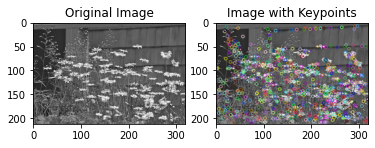

166


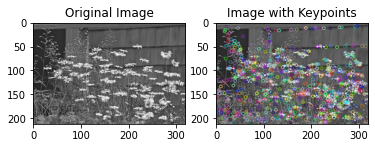

167


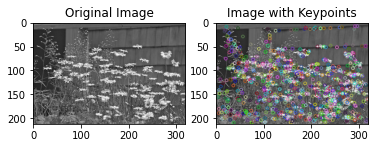

168


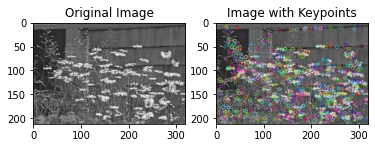

169


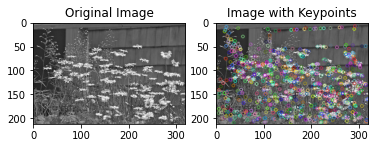

170


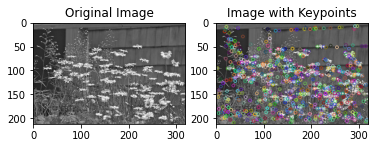

171


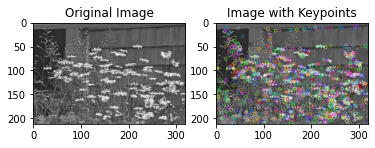

172


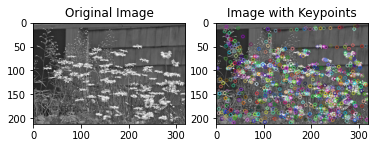

173


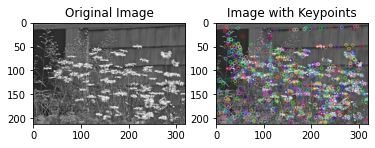

174


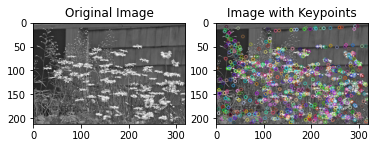

175


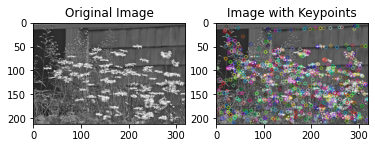

176


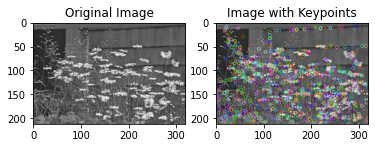

177


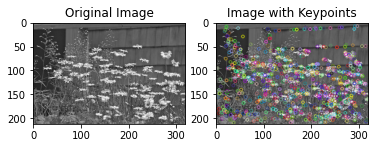

178


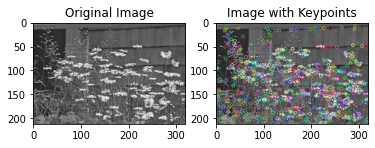

179


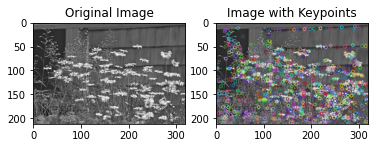

180


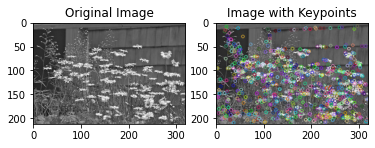

181


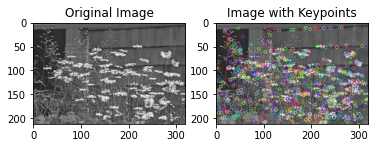

182


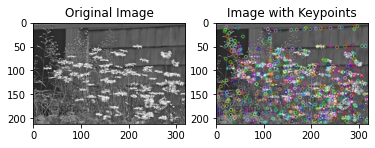

183


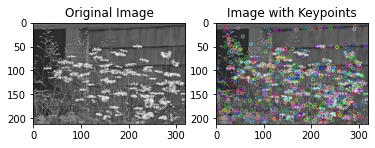

184


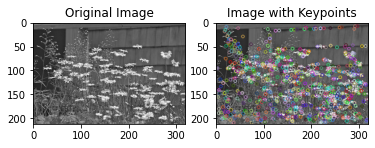

185


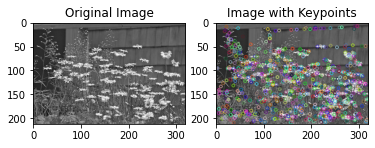

186


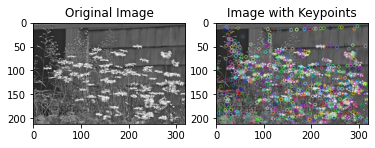

187


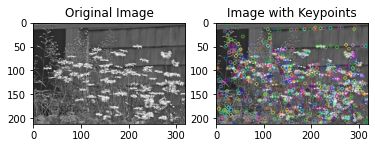

188


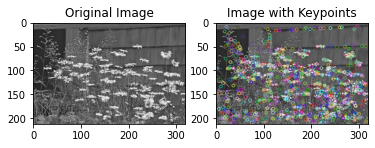

189


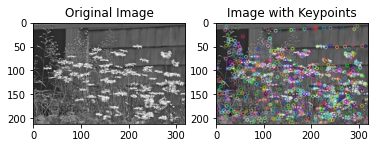

190


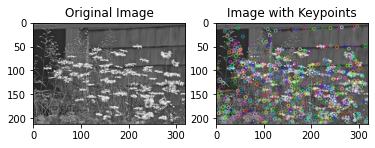

191


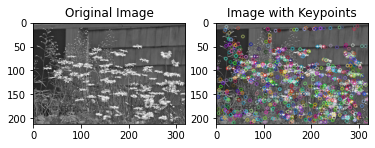

192


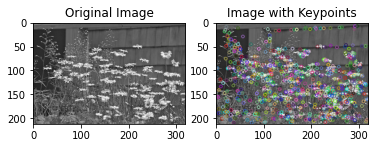

193


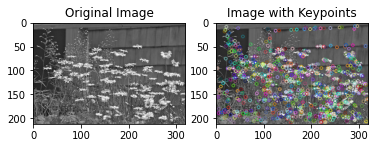

194


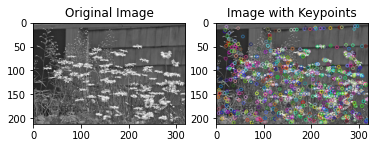

195


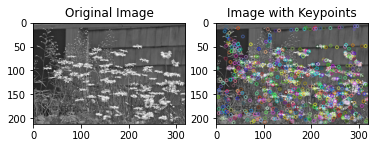

196


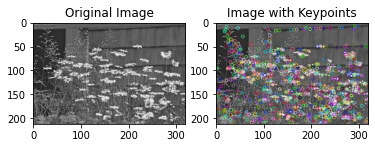

197


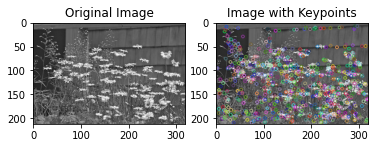

198


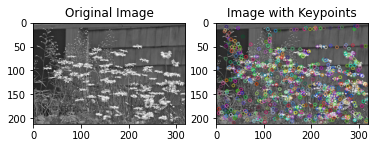

199


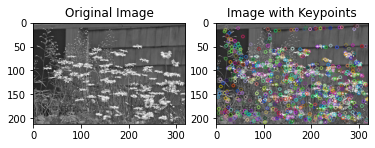

200


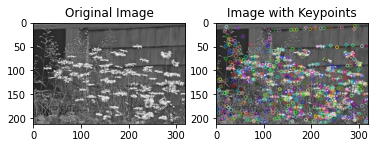

201


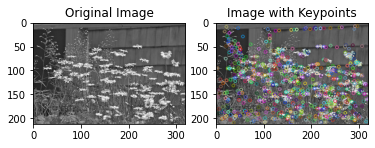

202


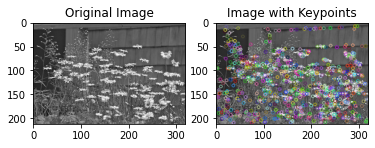

203


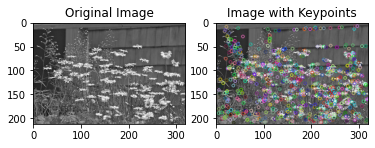

204


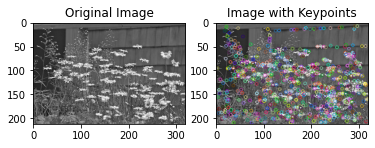

205


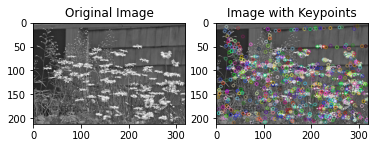

206


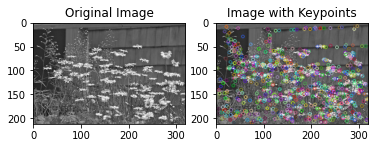

207


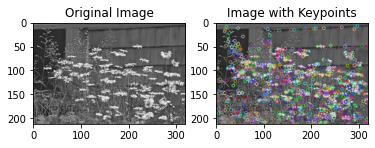

208


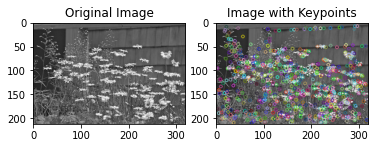

209


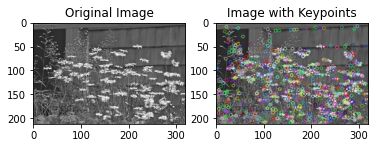

210


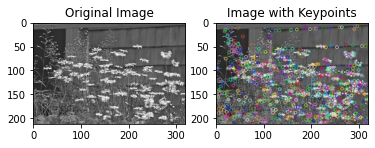

211


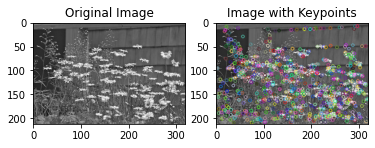

212


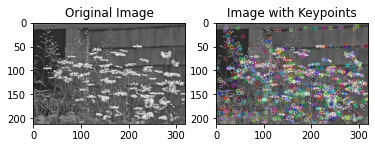

213


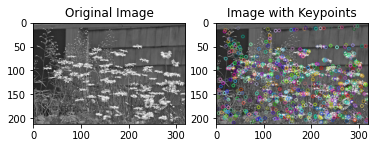

214


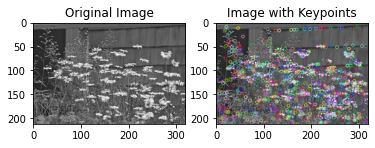

215


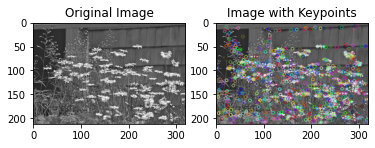

216


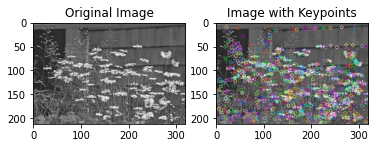

217


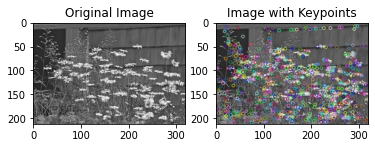

218


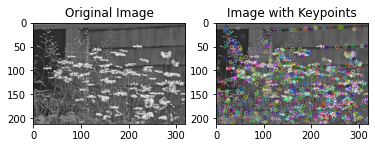

219


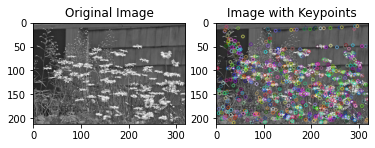

220


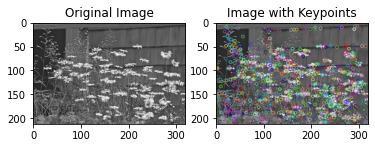

221


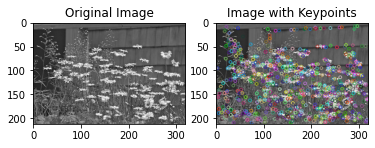

222


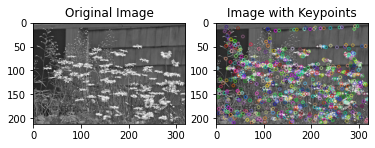

223


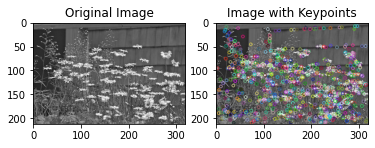

224


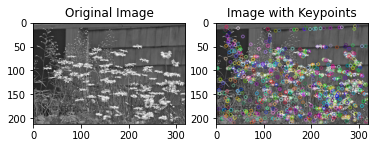

225


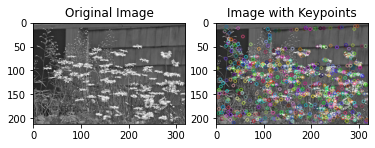

226


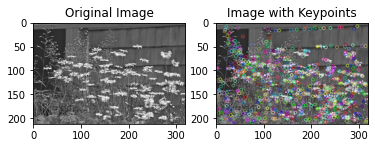

227


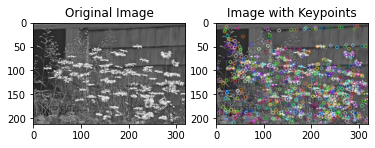

228


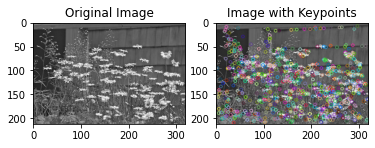

229


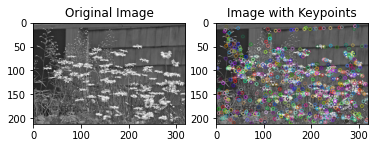

230


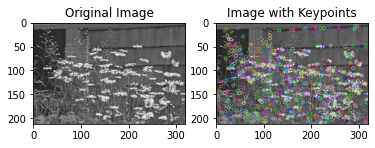

231


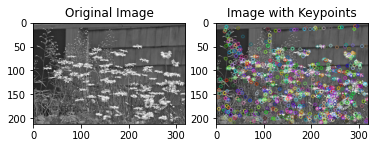

232


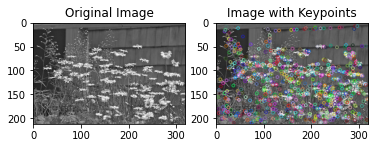

233


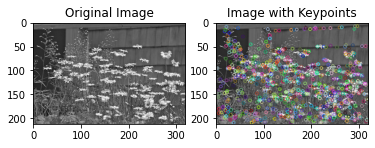

234


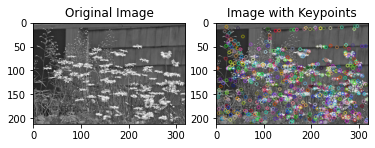

235


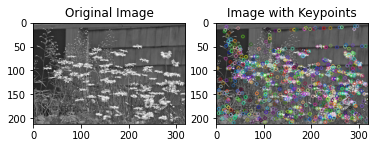

236


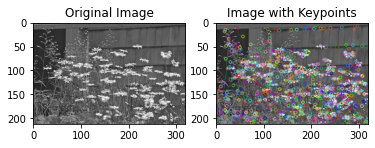

237


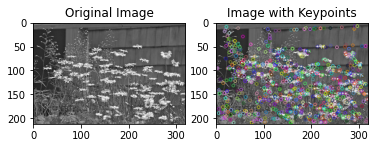

238


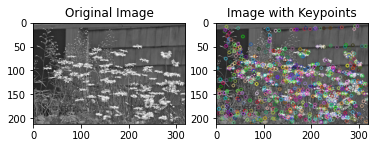

239


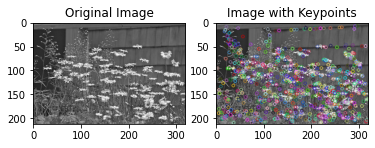

240


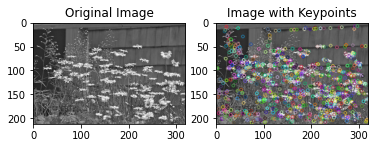

241


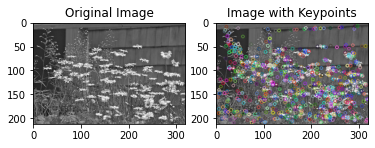

242


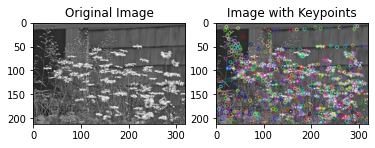

243


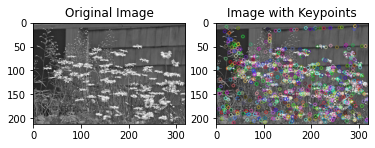

244


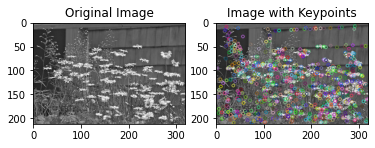

245


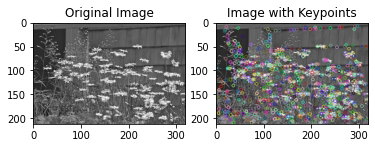

246


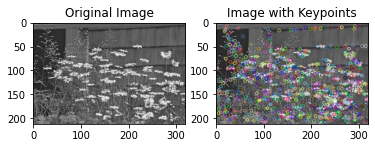

247


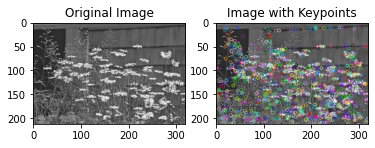

248


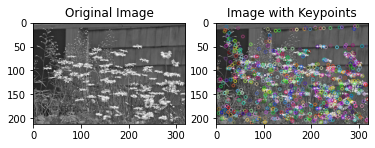

249


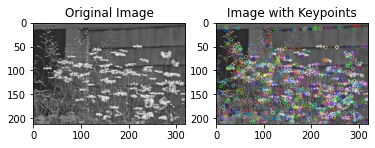

In [26]:
i=0
for img_path in path:
  i=i+1
  if i == 250:
        break  # exit loop after 100 iterations
  print(i)
  #Create a figure with two subplots
  fig, (ax1, ax2) = plt.subplots(1, 2)

  # Show the original image in the fit subplot
  ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  ax1.set_title('Original Image')

  # Show the image with keypoints in the second subplot
  img_keypoints = cv2.drawKeypoints(img, keypoint, None)
  ax2.imshow(cv2.cvtColor(img_keypoints, cv2.COLOR_BGR2RGB))
  ax2.set_title('Image with Keypoints')

  # Display the figure
  plt.show()

# **Codebook Generation using Kmeans**

In [11]:
num_clusters = 200 # Set number of clusters
descriptors = np.vstack(dataset_images)
kmeans = KMeans(n_clusters=num_clusters)
vocabulary = kmeans.fit(descriptor).cluster_centers_

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


**Calculate BoVW Histogram**

In [12]:
dataset_bow = []
for img_des in dataset_images:
    bow_hist = calculate_bow(img_des, vocabulary)
    dataset_bow.append(bow_hist)

**Plot the Histogram**

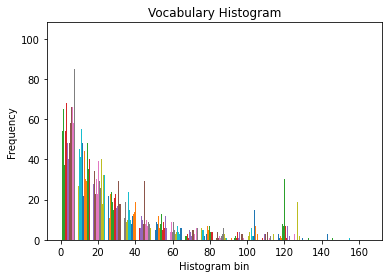

In [13]:
# Plot the histogram
plt.hist(vocabulary, bins=20)
plt.title("Vocabulary Histogram")
plt.xlabel("Histogram bin")
plt.ylabel("Frequency")
plt.show()

# **Split dataset into train and test sets**

In [14]:
num_instances = len(dataset_bow)
train_set_size = int(0.8 * num_instances)
#train_set_size = 200 # 80% of dataset 2 for training
train_idx = np.random.choice(len(dataset_bow), size=train_set_size, replace=False)
test_idx = np.setdiff1d(np.arange(len(dataset_bow)), train_idx)
X_train = np.array(dataset_bow)[train_idx]
y_train = np.array(dataset_labels)[train_idx]
X_test = np.array(dataset_bow)[test_idx]
y_test = np.array(dataset_labels)[test_idx]

# **SVM classifier**

**Training SVM**

In [15]:
# Train SVM classifier on Objects dataset
svm = SVC(kernel='rbf', C=1 ,probability=True)
svm.fit(X_train.reshape(X_train.shape[0], -1), y_train)

SVC(C=1, probability=True)

**Testing SVM**

In [16]:
# Make predictions on the test set and evaluate the accuracy
y_pred_svm = svm.predict(X_test.reshape(X_test.shape[0], -1))

**Accuracy**

In [17]:
accuracy = accuracy_score(y_test, y_pred_svm )
print("Accuracy: {:.2f}%".format(accuracy * 100))
#accuracy using kernel sigmoid: 27.66
#accuracy using kernel poly: 39.65
#accuracy using kernel linear: 27.66

Accuracy: 56.81%


**F1 Score**

In [18]:
# Calculate the F1 score
f1 = f1_score(y_test, y_pred_svm ,average=None)
print("F1 score:", f1)

# Calculate the F1 score
f1 = f1_score(y_test, y_pred_svm , average='weighted')
print("F1 score: {:.2f}".format(f1))

F1 score: [0.49302326 0.69647059 0.43514644 0.67383513 0.4516129 ]
F1 score: 0.57


**Confusion Matrix of SVM**

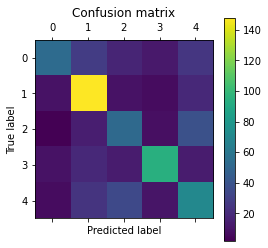

True Positives: [572 457 547 549 494]
False Positives: [82 44 62 54 75]


In [19]:
conf_mat = confusion_matrix(y_test, y_pred_svm)
showconfusionmatrix(conf_mat)

# **Random Forrest Classification**

**Training**

In [20]:
# Train a random forest classifier on the training set
rfc = RandomForestClassifier(n_estimators=100, max_depth=None, min_samples_split=2, random_state=0)
rfc.fit(X_train.reshape(X_train.shape[0], -1), y_train)

RandomForestClassifier(random_state=0)

**Testing**

In [21]:
# Make predictions on the test set and evaluate the accuracy
y_pred_rfc = rfc.predict(X_test.reshape(X_test.shape[0], -1))

**Accuracy**

In [22]:
accuracy = accuracy_score(y_test, y_pred_rfc)
print("Accuracy: {:.2f}%".format(accuracy * 100))

Accuracy: 53.00%


**F1 Score**

In [23]:

# Calculate the F1 score
f1 = f1_score(y_test, y_pred_rfc,average=None)
print("F1 score: ", f1)

# Calculate the F1 score
f1 = f1_score(y_test, y_pred_rfc, average='weighted')
print("F1 score: {:.2f}".format(f1))

F1 score:  [0.51948052 0.66990291 0.3652968  0.59259259 0.40776699]
F1 score: 0.53


**Confusion Matrix**

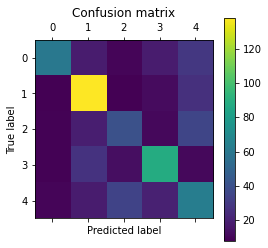

True Positives: [563 460 555 525 488]
False Positives: [75 54 74 60 82]


In [24]:
conf_mat = confusion_matrix(y_test, y_pred_rfc)
showconfusionmatrix(conf_mat)